[View in Colaboratory](https://colab.research.google.com/github/dkatsios/Yes_we_GAN/blob/master/Flags_DCGAN.ipynb)

# Flags DCGAN

### Imports

In [0]:
from keras.models import Model
from keras.layers import Input, Dense, BatchNormalization, Reshape, Flatten
from keras.layers import UpSampling2D, Conv2D
from keras.layers.advanced_activations import LeakyReLU
from keras.initializers import RandomNormal
from keras.datasets import fashion_mnist
from keras.optimizers import Adam

import numpy as np
import matplotlib.pyplot as plt
from IPython.display import Image

In [0]:
%%capture
%cd /content
%rm -r /content/Yes_we_GAN
!git clone https://github.com/dkatsios/Yes_we_GAN.git
flags_dir = '/content/Yes_we_GAN/flags/32x32/'

In [0]:
def flags_loader(flags_dir, img_shape, batch_size):
  from glob import glob
  from itertools import cycle
  flags_list = glob(flags_dir + '*.*')
  flags_list = cycle(flags_list)
  while True:
    imgs = np.zeros((batch_size, *img_shape))
    for i in range(batch_size):
      flag = next(flags_list)
      flag = plt.imread(flag)
      flag = flag * 2 - 1
      imgs[i] = flag
    
    yield imgs

### Function to build the generator

In [0]:
def build_generator(noise_size, img_shape):
  
  filters = 512
  k_size = 5, 5
  k_init = RandomNormal(0, 0.02)
  
  noise = Input((noise_size,))
  
  x = Dense(4*4*filters, activation='relu', kernel_initializer=k_init)(noise)
  x = Reshape((4, 4, filters))(x)  # 4, 4
  x = BatchNormalization()(x)
  x = UpSampling2D()(x)  # 8, 8
  
  x = Conv2D(filters // 2, k_size, padding='same', activation='relu', kernel_initializer=k_init)(x)
  x = BatchNormalization()(x)
  x = UpSampling2D()(x)  # 16, 16
  
  x = Conv2D(filters // 4, k_size, padding='same', activation='relu', kernel_initializer=k_init)(x)
  x = BatchNormalization()(x)
  x = UpSampling2D()(x)  # 32, 32
  
  img = Conv2D(img_shape[-1], k_size, padding='same', activation='tanh', kernel_initializer=k_init)(x)
  
  generator = Model(noise, img)
  return generator

### Function to build the discriminator

In [0]:
def build_discriminator(img_shape):
  
  filters = 512
  k_size = 5, 5
  k_init = RandomNormal(0, 0.02)
  
  img = Input(img_shape)  # 32, 32
  
  x = Conv2D(filters // 4, k_size, strides=(2, 2), padding='same', kernel_initializer=k_init)(img)
  x = BatchNormalization()(x)
  x = LeakyReLU(0.2)(x)  # 16, 16
  
  x = Conv2D(filters // 2, k_size, strides=(2, 2), padding='same', kernel_initializer=k_init)(img)
  x = BatchNormalization()(x)
  x = LeakyReLU(0.2)(x)  # 8, 8
  
  x = Conv2D(filters, k_size, strides=(2, 2), padding='same', kernel_initializer=k_init)(img)
  x = BatchNormalization()(x)
  x = LeakyReLU(0.2)(x)  # 4, 4
  
  x = Flatten()(x)
  validity = Dense(1, activation='sigmoid')(x)
  
  discriminator = Model(img, validity)
  return discriminator

### Function to compile the models

In [0]:
def get_compiled_models(generator, discriminator, noise_size):
  
  optimizer = Adam(0.0002, 0.5)
  
  discriminator.compile(optimizer, loss='binary_crossentropy', metrics=['accuracy'])
  discriminator.trainable = False
  
  noise = Input((noise_size,))
  img = generator(noise)
  validity = discriminator(img)
  combined = Model(noise, validity)
  
  combined.compile(optimizer, loss='binary_crossentropy')
  
  return generator, discriminator, combined

### Function to sample and save generated images

In [0]:
def sample_imgs(generator, noise_size, step, plot_img=True, cond=False, num_classes=10, gray=True):
  np.random.seed(0)
  
  r, c = num_classes, 10
  if cond:
    noise = np.random.normal(0, 1, (c, noise_size))
    noise = np.tile(noise, (r, 1))

    sampled_labels = np.arange(r).reshape(-1, 1)
    sampled_labels = to_categorical(sampled_labels, r)
    sampled_labels = np.repeat(sampled_labels, c, axis=0)

    imgs = generator.predict([noise, sampled_labels])
  else:
    noise = np.random.normal(0, 1, (r*c, noise_size))
    imgs = generator.predict_on_batch(noise)
  
  imgs = imgs / 2 + 0.5
  imgs = np.reshape(imgs, [r, c, imgs.shape[1], imgs.shape[2], -1])
  
  figsize = 1 * c, 1 * r
  fig, axs = plt.subplots(r, c, figsize=figsize)
  
  for i in range(r):
    for j in range(c):
      if gray:
        img = imgs[i, j] if len(imgs.shape) == 4 else imgs[i, j, :, :, 0]
        axs[i, j].imshow(img, cmap='gray')
      else:
        axs[i, j].imshow(imgs[i, j])
      axs[i, j].axis('off')
  plt.subplots_adjust(wspace=0.1, hspace=0.1)
  fig.savefig(f'/content/images/{step}.png')
  if plot_img:
    plt.show()
  plt.close()
  
  np.random.seed(None)

### Function to train the models

In [0]:
def train(models, noise_size, img_shape, batch_size, steps):
  
  generator, discriminator, combined = models
  #get real data iterator
  flags_iter = flags_loader(flags_dir, img_shape, batch_size)
  
  for step in range(1, steps + 1):
    # train discriminator
    real_imgs = next(flags_iter)
    real_validity = np.ones(batch_size)
    
    noise = np.random.normal(0, 1, (batch_size, noise_size))
    gen_imgs = generator.predict(noise)
    gen_validity = np.zeros(batch_size)
    
    r_loss = discriminator.train_on_batch(real_imgs, real_validity)
    g_loss = discriminator.train_on_batch(gen_imgs, gen_validity)
    disc_loss = np.add(r_loss, g_loss) / 2
    
    # train generator
    noise = np.random.normal(0, 1, (batch_size, noise_size))
    gen_validity = np.ones(batch_size)
    gen_loss = combined.train_on_batch(noise, gen_validity)
    
    #print progress
    if step % 50 == 0:
      print('step: %d, D_loss: %f, D_accuracy: %.2f%%, G_loss: %f' % (step, disc_loss[0],
                                                                      disc_loss[1] * 100, gen_loss))
    
    # save_samples
    if step % 200 == 0:
      sample_imgs(generator, noise_size, step, gray=False)

### Define hyperparameters

In [0]:
%rm -r /content/images
%mkdir /content/images
noise_size = 100
img_shape = 32, 32, 4
batch_size = 64
steps = 10000

### Generate the models

In [0]:
generator = build_generator(noise_size, img_shape)
discriminator = build_discriminator(img_shape)
compiled_models = get_compiled_models(generator, discriminator, noise_size)

### Train the models

/usr/local/lib/python3.6/dist-packages/keras/engine/training.py:975: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


step: 50, D_loss: 0.382057, D_accuracy: 85.94%, G_loss: 10.879912
step: 100, D_loss: 1.663620, D_accuracy: 50.00%, G_loss: 15.923887
step: 150, D_loss: 1.529952, D_accuracy: 52.34%, G_loss: 16.088318
step: 200, D_loss: 1.878654, D_accuracy: 63.28%, G_loss: 13.596665


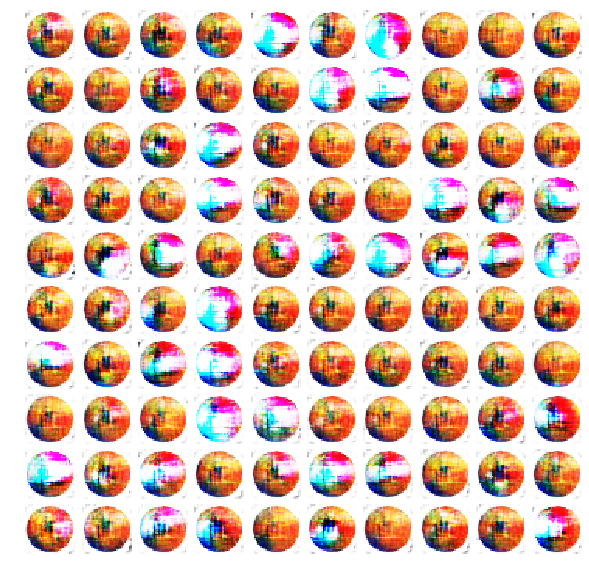

step: 250, D_loss: 2.610443, D_accuracy: 59.38%, G_loss: 3.407368
step: 300, D_loss: 2.077486, D_accuracy: 43.75%, G_loss: 16.048943
step: 350, D_loss: 0.542542, D_accuracy: 75.00%, G_loss: 5.441770
step: 400, D_loss: 0.382748, D_accuracy: 85.94%, G_loss: 4.649844


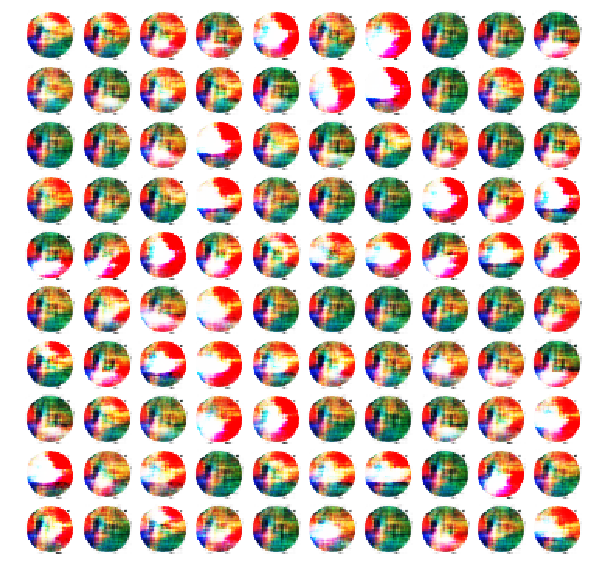

step: 450, D_loss: 0.205472, D_accuracy: 92.97%, G_loss: 4.252532
step: 500, D_loss: 1.434097, D_accuracy: 50.78%, G_loss: 13.656471
step: 550, D_loss: 0.345969, D_accuracy: 86.72%, G_loss: 4.023902
step: 600, D_loss: 0.102413, D_accuracy: 94.53%, G_loss: 4.303690


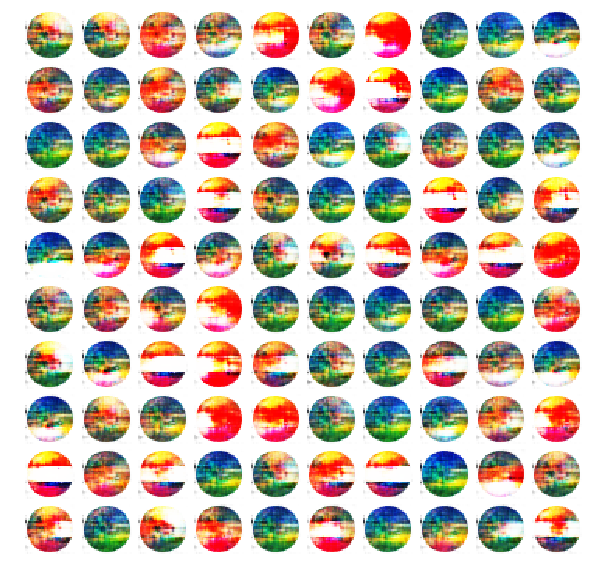

step: 650, D_loss: 0.358562, D_accuracy: 84.38%, G_loss: 8.498369
step: 700, D_loss: 0.126751, D_accuracy: 95.31%, G_loss: 4.818342
step: 750, D_loss: 0.056147, D_accuracy: 100.00%, G_loss: 4.832585
step: 800, D_loss: 0.633063, D_accuracy: 71.88%, G_loss: 4.524263


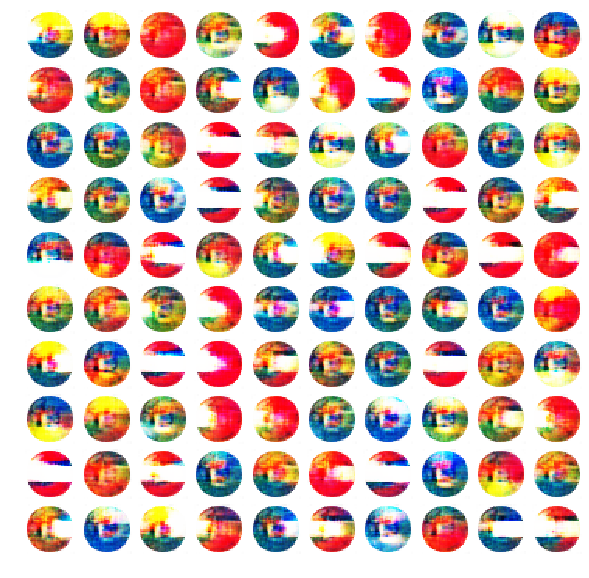

step: 850, D_loss: 0.106650, D_accuracy: 99.22%, G_loss: 4.083027
step: 900, D_loss: 0.190719, D_accuracy: 96.09%, G_loss: 4.193032
step: 950, D_loss: 0.361269, D_accuracy: 84.38%, G_loss: 4.253300
step: 1000, D_loss: 0.109501, D_accuracy: 97.66%, G_loss: 4.528358


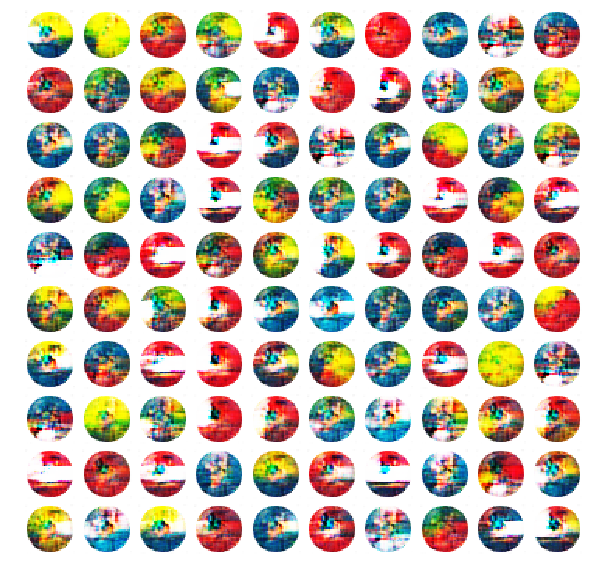

step: 1050, D_loss: 0.397082, D_accuracy: 85.94%, G_loss: 4.494221
step: 1100, D_loss: 1.035997, D_accuracy: 53.91%, G_loss: 7.154799
step: 1150, D_loss: 0.096164, D_accuracy: 98.44%, G_loss: 4.308788
step: 1200, D_loss: 0.556700, D_accuracy: 72.66%, G_loss: 6.642382


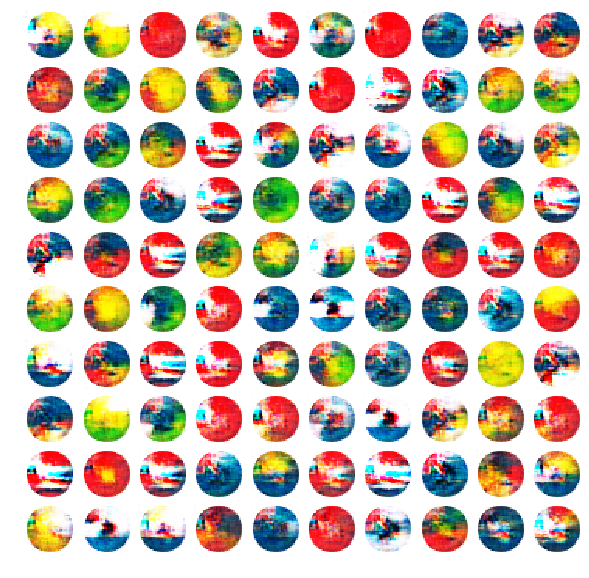

step: 1250, D_loss: 0.093710, D_accuracy: 98.44%, G_loss: 4.865317
step: 1300, D_loss: 0.061410, D_accuracy: 99.22%, G_loss: 4.212126
step: 1350, D_loss: 0.166864, D_accuracy: 95.31%, G_loss: 4.123241
step: 1400, D_loss: 0.163861, D_accuracy: 93.75%, G_loss: 4.273515


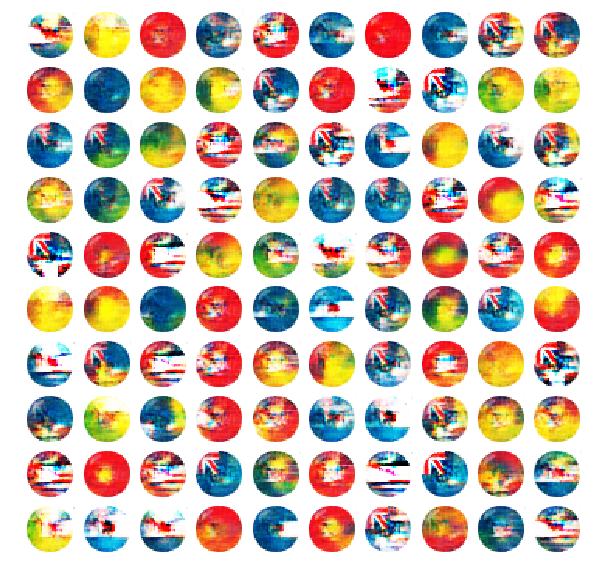

step: 1450, D_loss: 0.116034, D_accuracy: 99.22%, G_loss: 4.177570
step: 1500, D_loss: 0.215236, D_accuracy: 94.53%, G_loss: 7.169634
step: 1550, D_loss: 0.115040, D_accuracy: 99.22%, G_loss: 3.897686
step: 1600, D_loss: 0.361347, D_accuracy: 85.94%, G_loss: 3.464563


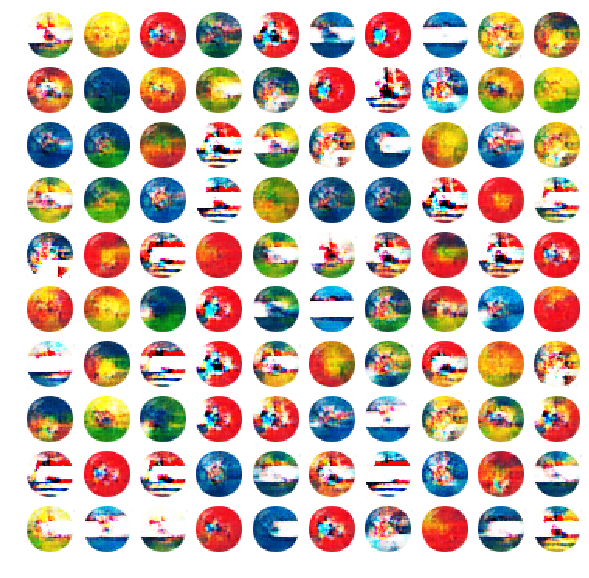

step: 1650, D_loss: 2.592832, D_accuracy: 55.47%, G_loss: 9.176634
step: 1700, D_loss: 0.484895, D_accuracy: 75.00%, G_loss: 6.624451
step: 1750, D_loss: 0.189164, D_accuracy: 96.09%, G_loss: 3.315190
step: 1800, D_loss: 0.107192, D_accuracy: 97.66%, G_loss: 3.031370


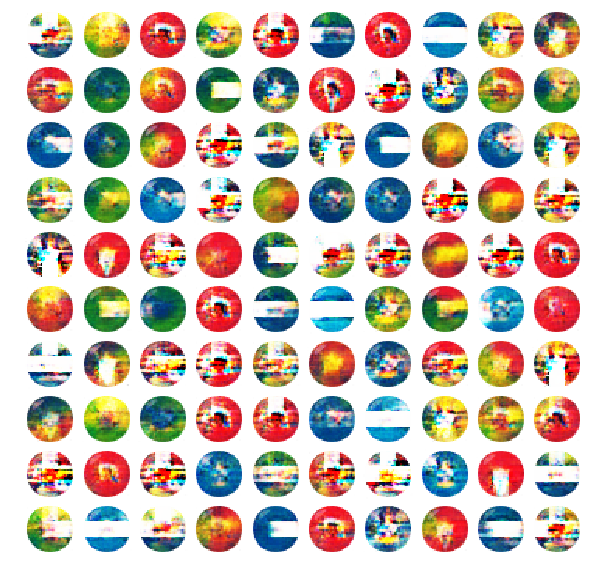

step: 1850, D_loss: 0.105582, D_accuracy: 99.22%, G_loss: 3.436165
step: 1900, D_loss: 0.151038, D_accuracy: 94.53%, G_loss: 5.543916
step: 1950, D_loss: 0.069503, D_accuracy: 99.22%, G_loss: 5.010220
step: 2000, D_loss: 0.109355, D_accuracy: 97.66%, G_loss: 5.484753


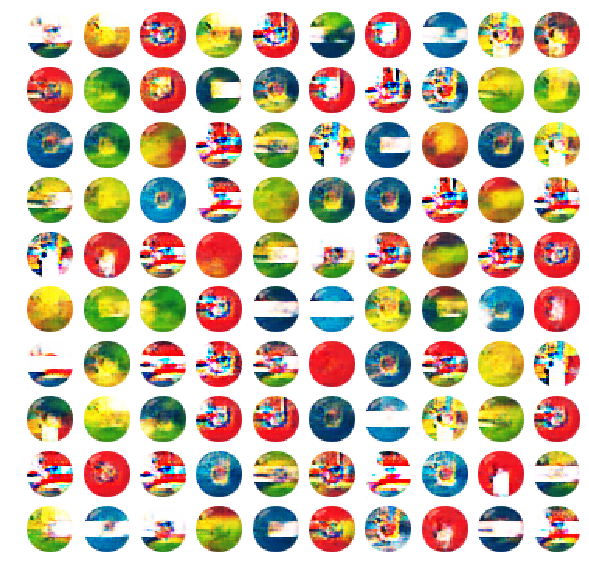

step: 2050, D_loss: 0.175530, D_accuracy: 93.75%, G_loss: 4.350938
step: 2100, D_loss: 0.172227, D_accuracy: 92.97%, G_loss: 7.342872
step: 2150, D_loss: 0.064516, D_accuracy: 100.00%, G_loss: 3.283148
step: 2200, D_loss: 0.097911, D_accuracy: 100.00%, G_loss: 3.995203


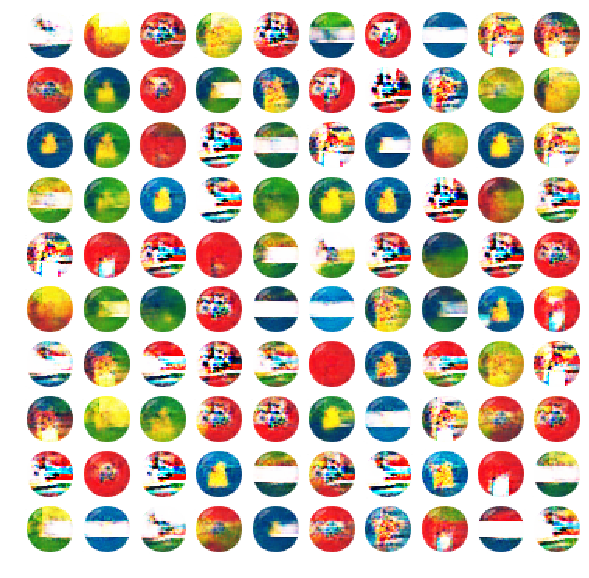

step: 2250, D_loss: 0.151030, D_accuracy: 96.88%, G_loss: 3.692585
step: 2300, D_loss: 0.047897, D_accuracy: 100.00%, G_loss: 3.429216
step: 2350, D_loss: 0.248773, D_accuracy: 88.28%, G_loss: 7.162510
step: 2400, D_loss: 0.105223, D_accuracy: 97.66%, G_loss: 2.660418


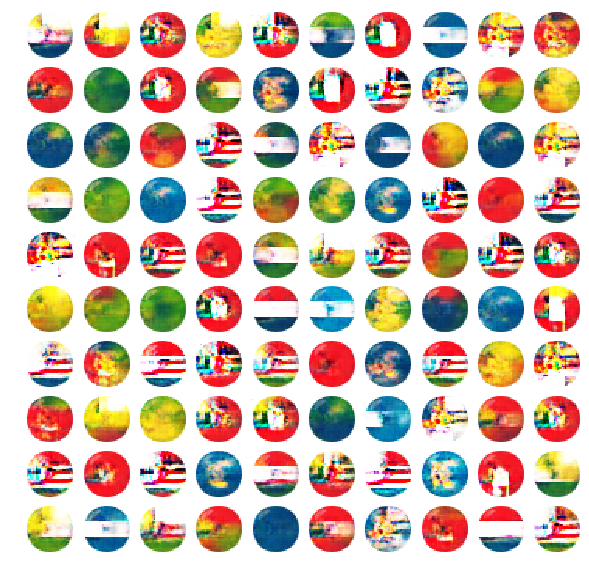

step: 2450, D_loss: 0.065993, D_accuracy: 100.00%, G_loss: 4.398150
step: 2500, D_loss: 0.053835, D_accuracy: 99.22%, G_loss: 3.932007
step: 2550, D_loss: 0.049814, D_accuracy: 100.00%, G_loss: 4.010627
step: 2600, D_loss: 0.187798, D_accuracy: 88.28%, G_loss: 5.163903


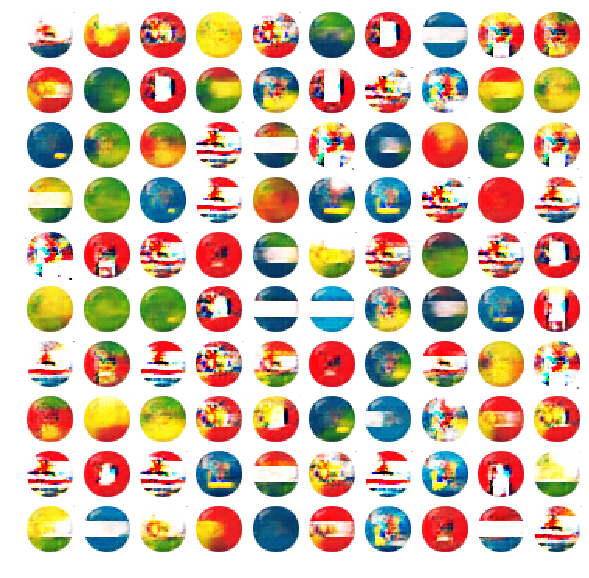

step: 2650, D_loss: 0.033083, D_accuracy: 100.00%, G_loss: 4.881896
step: 2700, D_loss: 0.188179, D_accuracy: 91.41%, G_loss: 6.474153
step: 2750, D_loss: 0.109288, D_accuracy: 97.66%, G_loss: 4.937044
step: 2800, D_loss: 0.144165, D_accuracy: 97.66%, G_loss: 3.640628


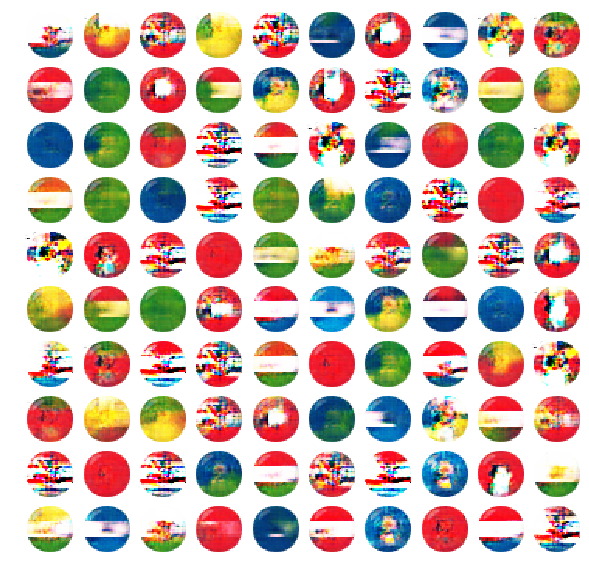

step: 2850, D_loss: 0.048272, D_accuracy: 100.00%, G_loss: 4.519259
step: 2900, D_loss: 0.098661, D_accuracy: 99.22%, G_loss: 4.797871
step: 2950, D_loss: 0.231577, D_accuracy: 87.50%, G_loss: 7.944462
step: 3000, D_loss: 0.067414, D_accuracy: 100.00%, G_loss: 4.317595


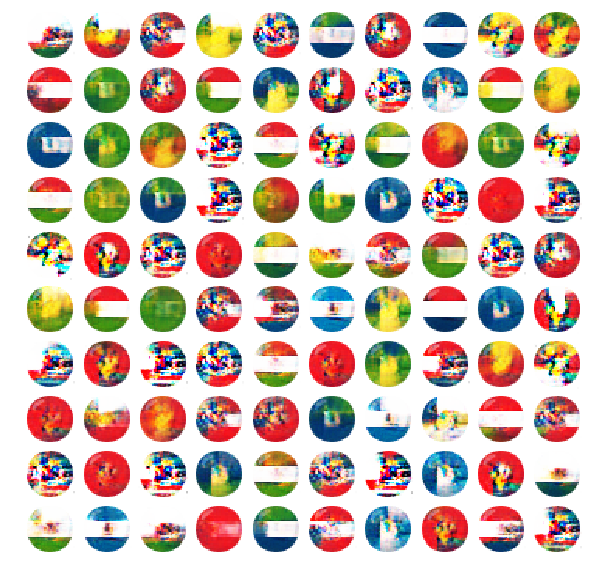

step: 3050, D_loss: 1.346200, D_accuracy: 62.50%, G_loss: 11.903498
step: 3100, D_loss: 0.043362, D_accuracy: 100.00%, G_loss: 3.948133
step: 3150, D_loss: 0.057787, D_accuracy: 100.00%, G_loss: 4.051785
step: 3200, D_loss: 2.055603, D_accuracy: 49.22%, G_loss: 9.371213


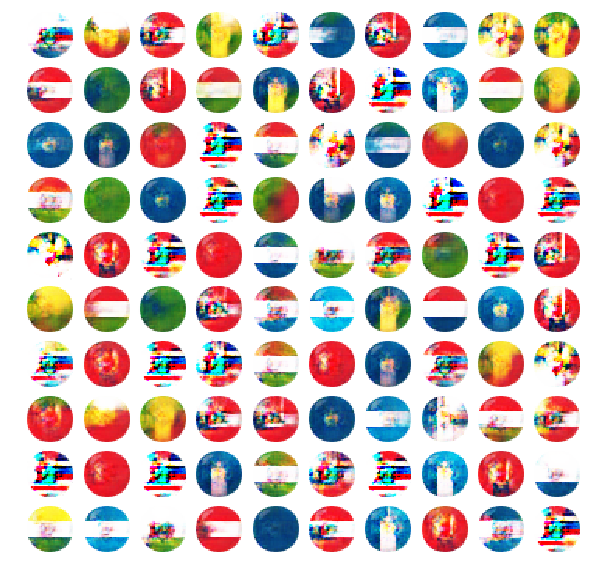

step: 3250, D_loss: 0.088958, D_accuracy: 98.44%, G_loss: 4.063074
step: 3300, D_loss: 0.193126, D_accuracy: 89.84%, G_loss: 6.139792
step: 3350, D_loss: 0.033172, D_accuracy: 100.00%, G_loss: 4.359213
step: 3400, D_loss: 0.036518, D_accuracy: 100.00%, G_loss: 4.718248


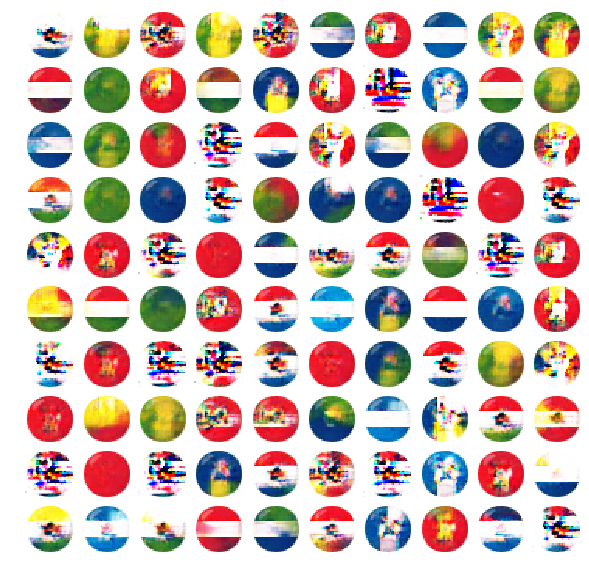

step: 3450, D_loss: 1.527811, D_accuracy: 60.94%, G_loss: 11.316875
step: 3500, D_loss: 0.073186, D_accuracy: 98.44%, G_loss: 5.226084
step: 3550, D_loss: 0.045328, D_accuracy: 99.22%, G_loss: 5.314216
step: 3600, D_loss: 0.057360, D_accuracy: 98.44%, G_loss: 4.430675


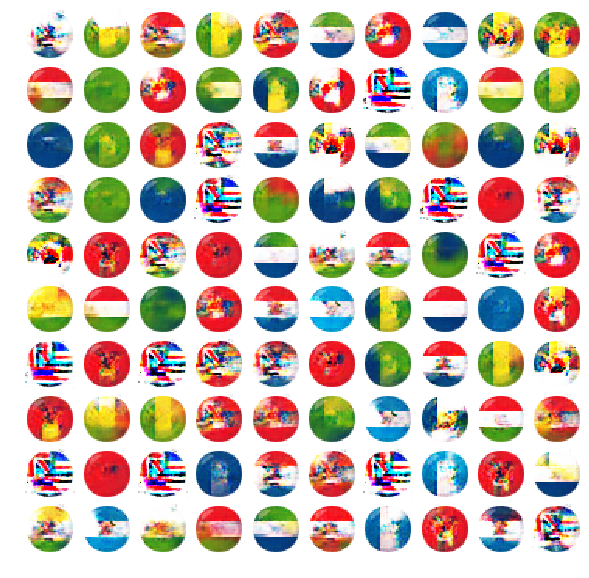

step: 3650, D_loss: 0.725790, D_accuracy: 77.34%, G_loss: 7.825849
step: 3700, D_loss: 0.083935, D_accuracy: 98.44%, G_loss: 5.126995
step: 3750, D_loss: 0.070398, D_accuracy: 99.22%, G_loss: 4.553000
step: 3800, D_loss: 0.090829, D_accuracy: 96.88%, G_loss: 5.279016


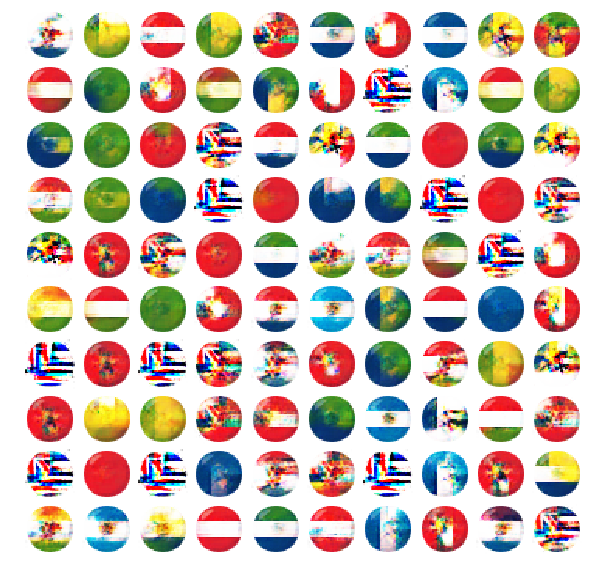

step: 3850, D_loss: 0.024209, D_accuracy: 100.00%, G_loss: 4.853478
step: 3900, D_loss: 0.116373, D_accuracy: 96.09%, G_loss: 5.183187
step: 3950, D_loss: 1.687124, D_accuracy: 50.00%, G_loss: 10.221895
step: 4000, D_loss: 0.518368, D_accuracy: 74.22%, G_loss: 7.021947


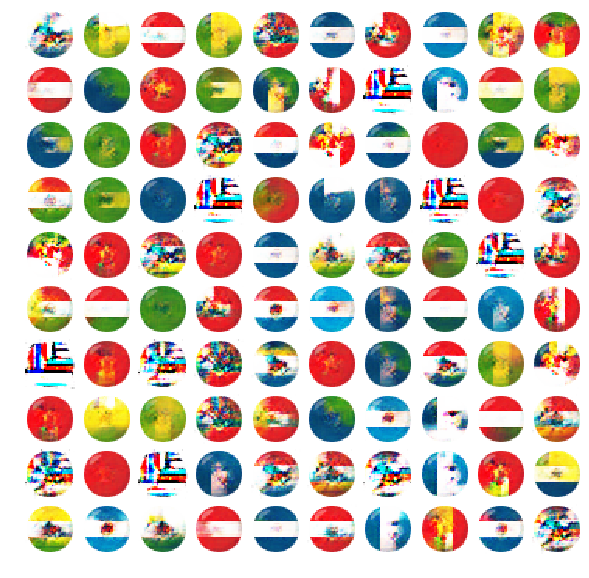

step: 4050, D_loss: 0.089868, D_accuracy: 98.44%, G_loss: 7.394614
step: 4100, D_loss: 0.115464, D_accuracy: 99.22%, G_loss: 5.636047
step: 4150, D_loss: 0.058123, D_accuracy: 99.22%, G_loss: 4.897682
step: 4200, D_loss: 0.070487, D_accuracy: 99.22%, G_loss: 6.105152


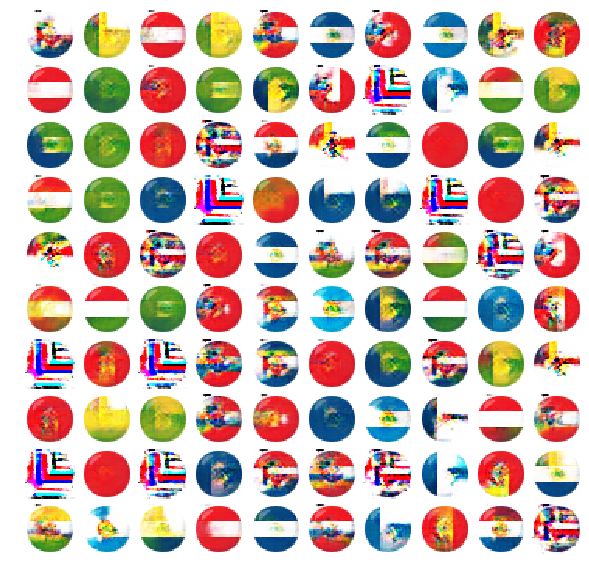

step: 4250, D_loss: 0.059909, D_accuracy: 99.22%, G_loss: 5.447148
step: 4300, D_loss: 0.115425, D_accuracy: 98.44%, G_loss: 4.979568
step: 4350, D_loss: 0.075944, D_accuracy: 98.44%, G_loss: 4.584129
step: 4400, D_loss: 0.052708, D_accuracy: 99.22%, G_loss: 4.586233


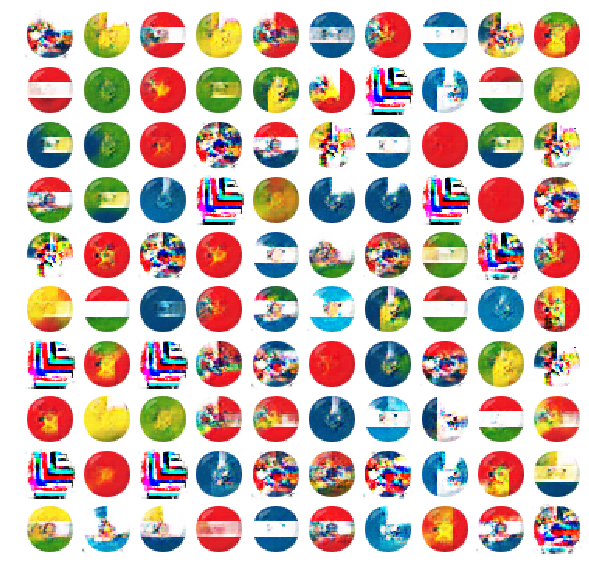

step: 4450, D_loss: 0.100277, D_accuracy: 97.66%, G_loss: 5.633232
step: 4500, D_loss: 0.118827, D_accuracy: 96.09%, G_loss: 6.225077
step: 4550, D_loss: 0.108391, D_accuracy: 96.88%, G_loss: 6.119926
step: 4600, D_loss: 0.053051, D_accuracy: 99.22%, G_loss: 5.772650


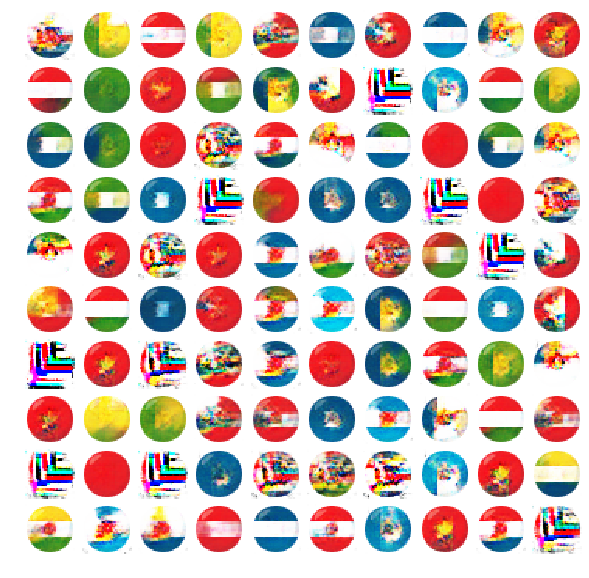

step: 4650, D_loss: 0.051782, D_accuracy: 100.00%, G_loss: 5.445372
step: 4700, D_loss: 0.435419, D_accuracy: 85.94%, G_loss: 5.702314
step: 4750, D_loss: 0.025850, D_accuracy: 100.00%, G_loss: 5.791040
step: 4800, D_loss: 0.059383, D_accuracy: 99.22%, G_loss: 6.606399


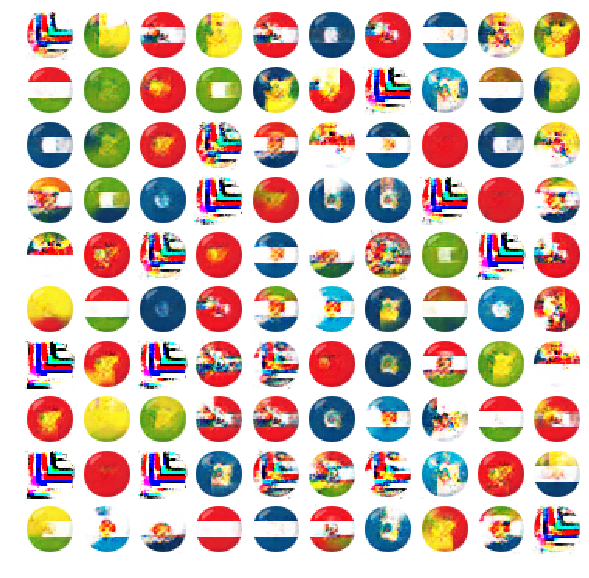

step: 4850, D_loss: 0.886327, D_accuracy: 77.34%, G_loss: 8.230812
step: 4900, D_loss: 0.053231, D_accuracy: 99.22%, G_loss: 6.151636
step: 4950, D_loss: 0.051161, D_accuracy: 99.22%, G_loss: 5.318268
step: 5000, D_loss: 0.108955, D_accuracy: 98.44%, G_loss: 6.017198


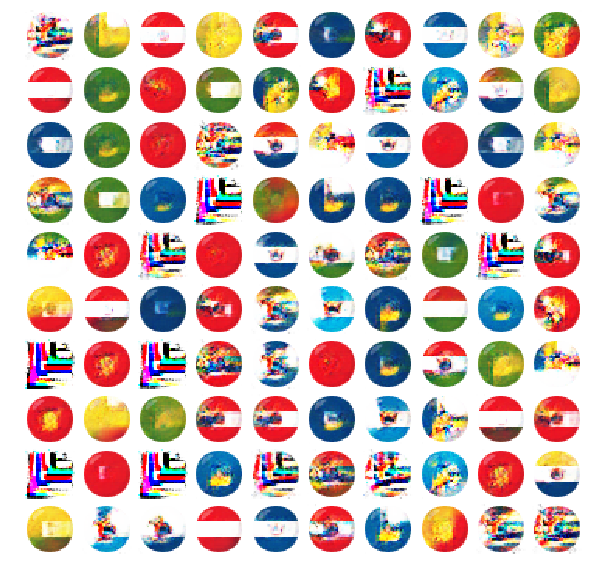

step: 5050, D_loss: 0.044541, D_accuracy: 99.22%, G_loss: 5.388163
step: 5100, D_loss: 0.229224, D_accuracy: 88.28%, G_loss: 9.409501
step: 5150, D_loss: 0.048685, D_accuracy: 99.22%, G_loss: 5.216255
step: 5200, D_loss: 0.174928, D_accuracy: 94.53%, G_loss: 5.818619


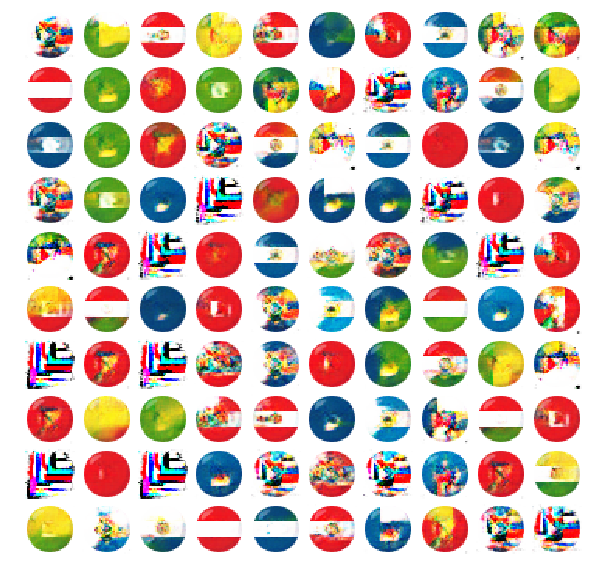

step: 5250, D_loss: 0.056568, D_accuracy: 100.00%, G_loss: 5.290662
step: 5300, D_loss: 0.060036, D_accuracy: 99.22%, G_loss: 5.520986
step: 5350, D_loss: 0.058153, D_accuracy: 97.66%, G_loss: 5.074713
step: 5400, D_loss: 0.040709, D_accuracy: 100.00%, G_loss: 4.949615


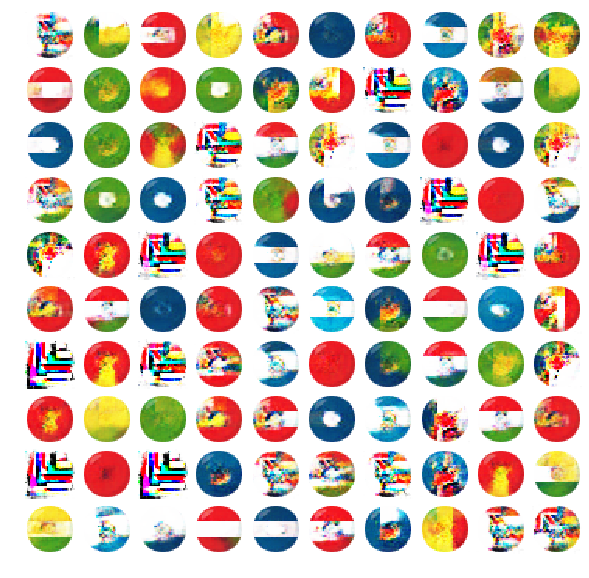

step: 5450, D_loss: 0.109221, D_accuracy: 97.66%, G_loss: 9.609034
step: 5500, D_loss: 0.172495, D_accuracy: 93.75%, G_loss: 7.673824
step: 5550, D_loss: 0.074234, D_accuracy: 98.44%, G_loss: 5.056294
step: 5600, D_loss: 0.036840, D_accuracy: 100.00%, G_loss: 5.392445


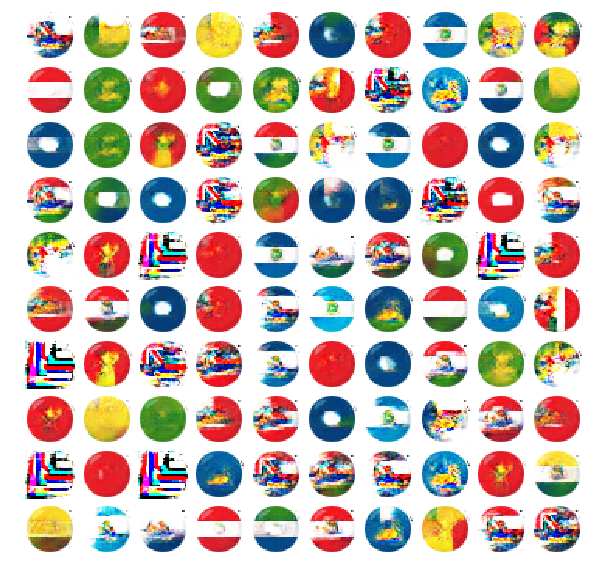

step: 5650, D_loss: 0.102475, D_accuracy: 99.22%, G_loss: 4.490422
step: 5700, D_loss: 0.026011, D_accuracy: 100.00%, G_loss: 5.109849
step: 5750, D_loss: 0.059199, D_accuracy: 98.44%, G_loss: 5.781965
step: 5800, D_loss: 0.445096, D_accuracy: 78.12%, G_loss: 9.321342


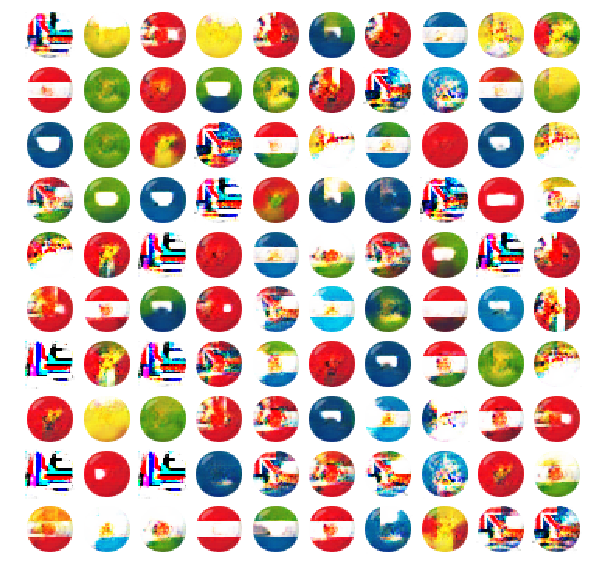

step: 5850, D_loss: 0.061834, D_accuracy: 100.00%, G_loss: 4.765217
step: 5900, D_loss: 0.303827, D_accuracy: 89.84%, G_loss: 6.146962
step: 5950, D_loss: 0.055801, D_accuracy: 100.00%, G_loss: 5.686376
step: 6000, D_loss: 0.055863, D_accuracy: 99.22%, G_loss: 4.833430


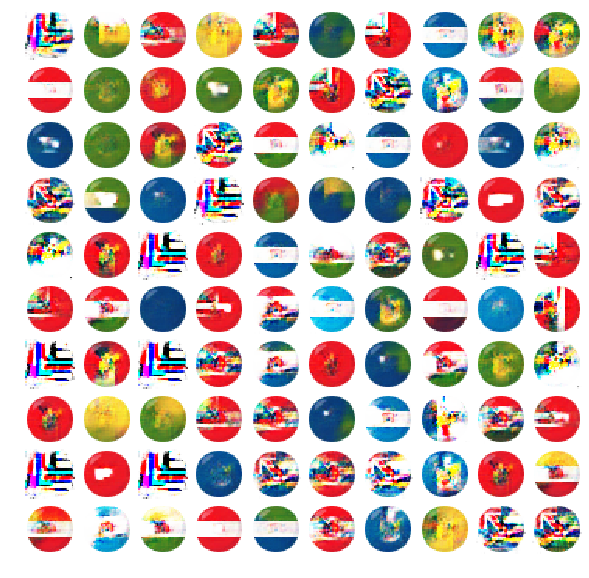

step: 6050, D_loss: 0.041585, D_accuracy: 100.00%, G_loss: 4.834460
step: 6100, D_loss: 0.062678, D_accuracy: 100.00%, G_loss: 5.703077
step: 6150, D_loss: 0.047079, D_accuracy: 99.22%, G_loss: 7.392702
step: 6200, D_loss: 0.042035, D_accuracy: 99.22%, G_loss: 5.652148


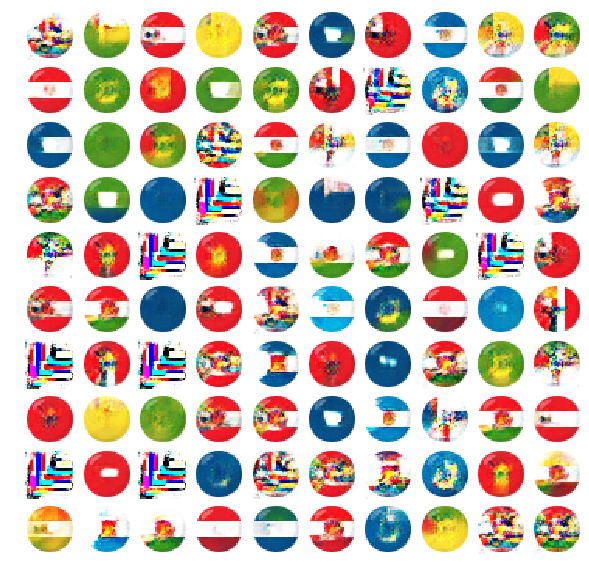

step: 6250, D_loss: 0.047620, D_accuracy: 99.22%, G_loss: 4.608854
step: 6300, D_loss: 0.179850, D_accuracy: 91.41%, G_loss: 5.483853
step: 6350, D_loss: 0.027804, D_accuracy: 99.22%, G_loss: 5.789137
step: 6400, D_loss: 0.048734, D_accuracy: 100.00%, G_loss: 5.163429


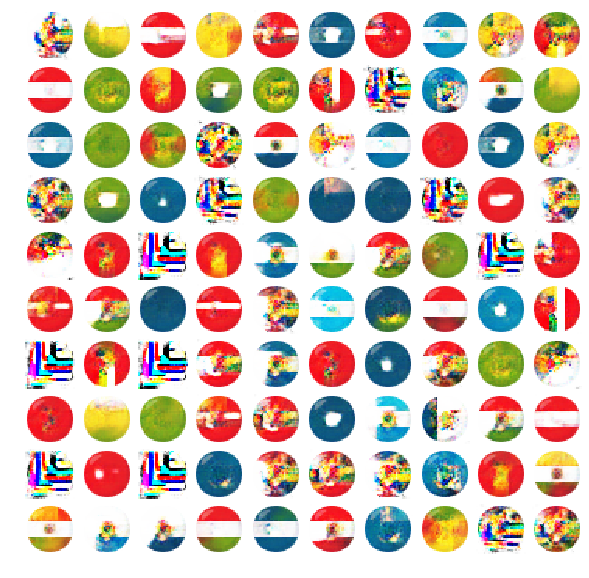

step: 6450, D_loss: 0.325362, D_accuracy: 91.41%, G_loss: 9.432251
step: 6500, D_loss: 0.095509, D_accuracy: 98.44%, G_loss: 5.444210
step: 6550, D_loss: 0.040986, D_accuracy: 100.00%, G_loss: 5.926444
step: 6600, D_loss: 2.311911, D_accuracy: 56.25%, G_loss: 10.769475


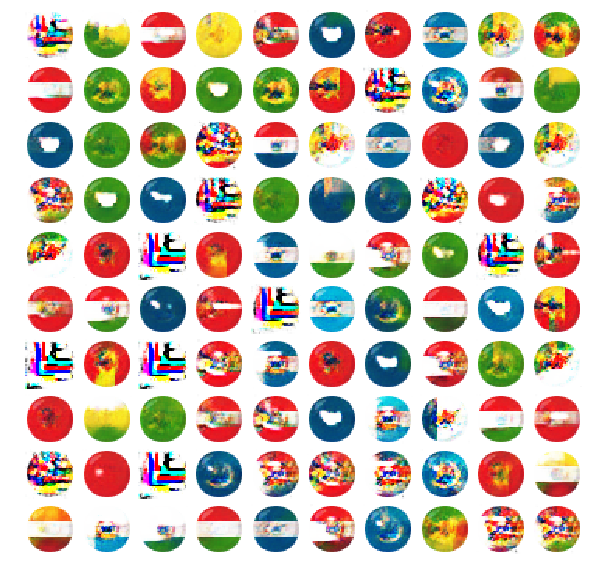

step: 6650, D_loss: 0.065963, D_accuracy: 96.88%, G_loss: 5.211775
step: 6700, D_loss: 0.032471, D_accuracy: 100.00%, G_loss: 4.511601
step: 6750, D_loss: 0.038300, D_accuracy: 98.44%, G_loss: 5.810381
step: 6800, D_loss: 1.487813, D_accuracy: 77.34%, G_loss: 6.905627


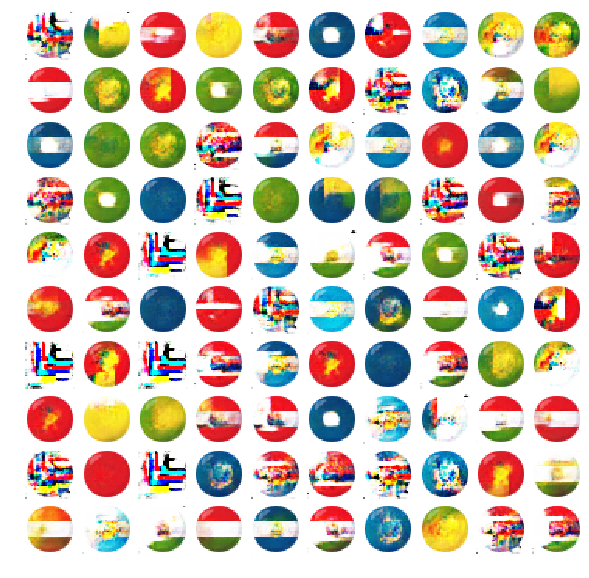

step: 6850, D_loss: 0.023337, D_accuracy: 100.00%, G_loss: 5.618046
step: 6900, D_loss: 0.015984, D_accuracy: 100.00%, G_loss: 4.636001
step: 6950, D_loss: 0.035832, D_accuracy: 99.22%, G_loss: 6.486238
step: 7000, D_loss: 0.155905, D_accuracy: 93.75%, G_loss: 6.874905


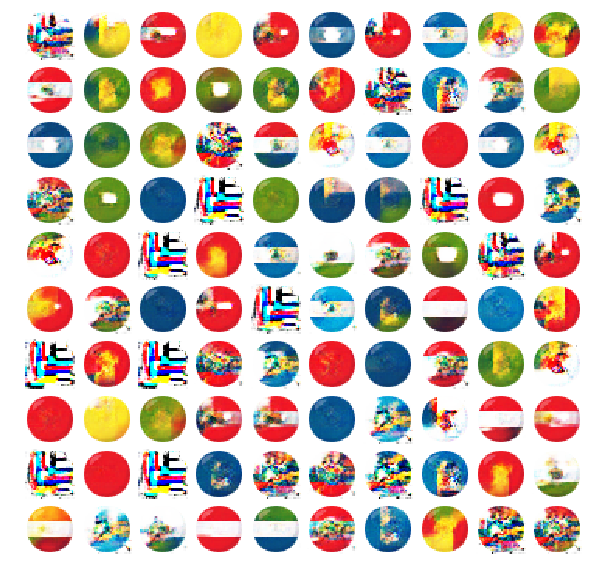

step: 7050, D_loss: 0.043123, D_accuracy: 100.00%, G_loss: 5.597363
step: 7100, D_loss: 0.026106, D_accuracy: 100.00%, G_loss: 5.722925
step: 7150, D_loss: 0.027405, D_accuracy: 100.00%, G_loss: 6.117156
step: 7200, D_loss: 0.057080, D_accuracy: 99.22%, G_loss: 7.288173


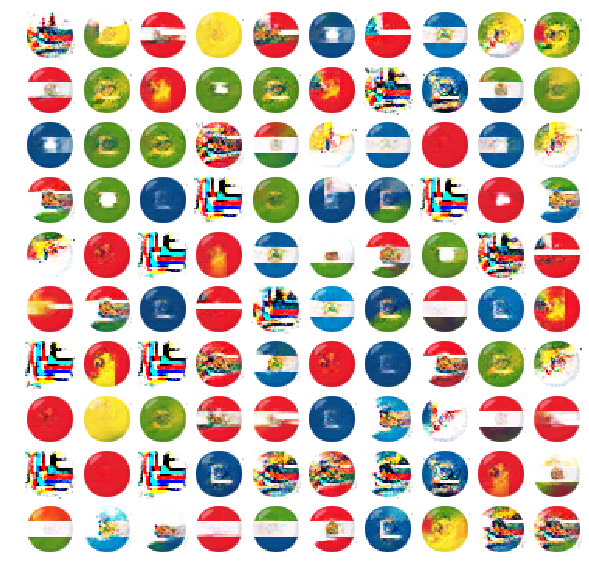

step: 7250, D_loss: 0.047079, D_accuracy: 99.22%, G_loss: 5.653897
step: 7300, D_loss: 0.038010, D_accuracy: 100.00%, G_loss: 7.006269
step: 7350, D_loss: 0.054887, D_accuracy: 100.00%, G_loss: 6.446729
step: 7400, D_loss: 0.067063, D_accuracy: 97.66%, G_loss: 5.901660


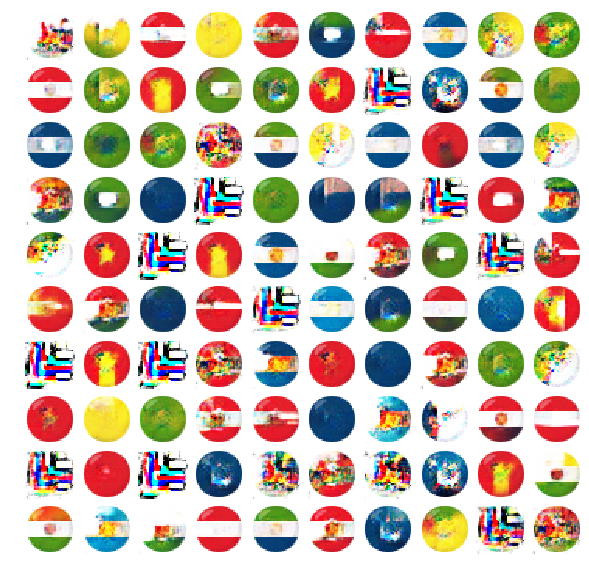

step: 7450, D_loss: 0.674007, D_accuracy: 72.66%, G_loss: 7.754867
step: 7500, D_loss: 0.084184, D_accuracy: 96.88%, G_loss: 4.621986
step: 7550, D_loss: 0.035125, D_accuracy: 100.00%, G_loss: 4.448768
step: 7600, D_loss: 0.068316, D_accuracy: 96.88%, G_loss: 5.107096


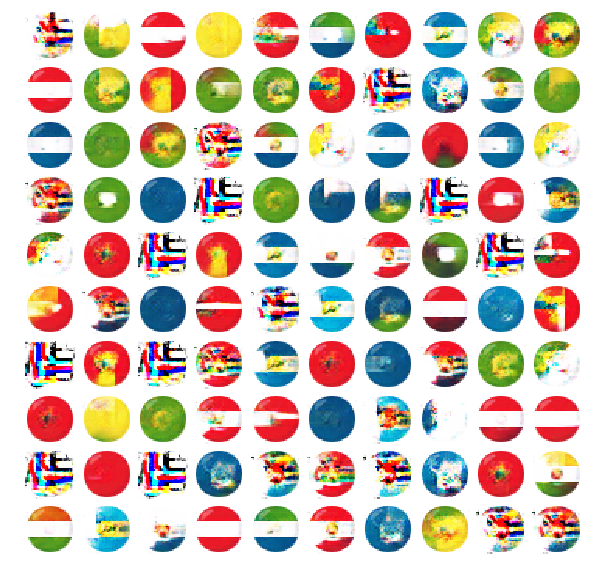

step: 7650, D_loss: 0.135147, D_accuracy: 98.44%, G_loss: 5.445585
step: 7700, D_loss: 0.025570, D_accuracy: 100.00%, G_loss: 6.485806
step: 7750, D_loss: 0.047006, D_accuracy: 99.22%, G_loss: 6.106440
step: 7800, D_loss: 0.122117, D_accuracy: 96.88%, G_loss: 7.066730


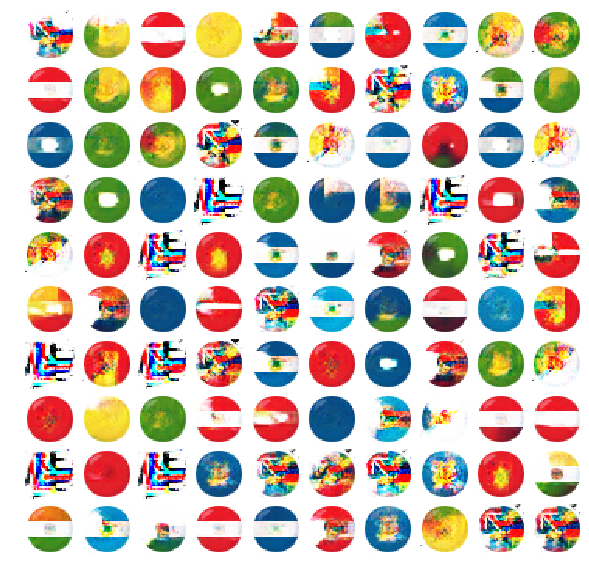

step: 7850, D_loss: 0.081038, D_accuracy: 98.44%, G_loss: 5.962893
step: 7900, D_loss: 0.081503, D_accuracy: 96.88%, G_loss: 5.561928
step: 7950, D_loss: 0.041360, D_accuracy: 100.00%, G_loss: 5.401973
step: 8000, D_loss: 0.074132, D_accuracy: 99.22%, G_loss: 5.756778


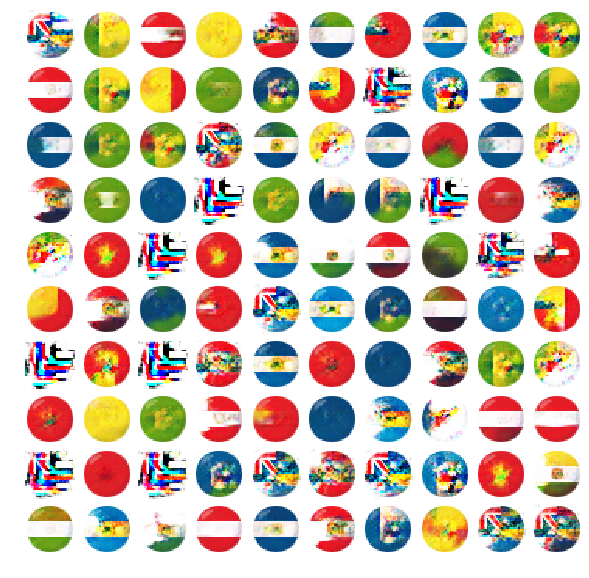

step: 8050, D_loss: 0.060220, D_accuracy: 98.44%, G_loss: 4.637871
step: 8100, D_loss: 0.021241, D_accuracy: 100.00%, G_loss: 4.989467
step: 8150, D_loss: 0.054081, D_accuracy: 98.44%, G_loss: 5.515312
step: 8200, D_loss: 0.029969, D_accuracy: 100.00%, G_loss: 5.964973


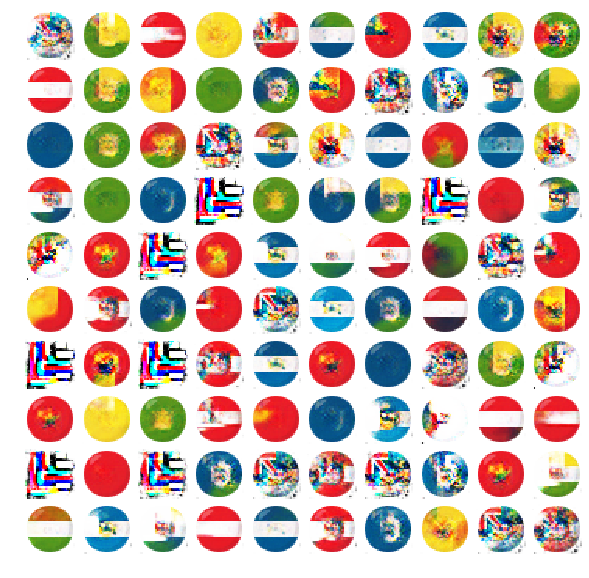

step: 8250, D_loss: 0.042485, D_accuracy: 100.00%, G_loss: 4.506899
step: 8300, D_loss: 0.086338, D_accuracy: 97.66%, G_loss: 5.768371
step: 8350, D_loss: 0.028246, D_accuracy: 100.00%, G_loss: 5.604969
step: 8400, D_loss: 0.066172, D_accuracy: 96.09%, G_loss: 8.385442


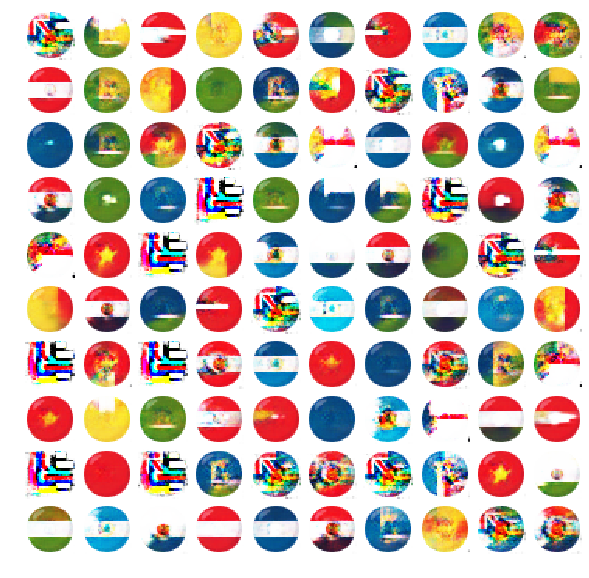

step: 8450, D_loss: 0.014979, D_accuracy: 100.00%, G_loss: 4.923050
step: 8500, D_loss: 0.011935, D_accuracy: 100.00%, G_loss: 6.596159
step: 8550, D_loss: 0.014520, D_accuracy: 100.00%, G_loss: 6.536721
step: 8600, D_loss: 0.044428, D_accuracy: 98.44%, G_loss: 6.228478


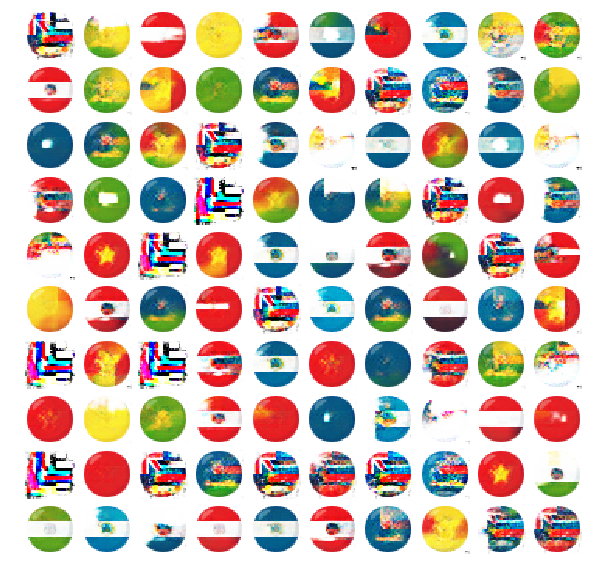

step: 8650, D_loss: 0.029778, D_accuracy: 100.00%, G_loss: 6.016351
step: 8700, D_loss: 0.064647, D_accuracy: 97.66%, G_loss: 6.548884
step: 8750, D_loss: 1.028898, D_accuracy: 67.19%, G_loss: 13.318472
step: 8800, D_loss: 0.046404, D_accuracy: 99.22%, G_loss: 5.541848


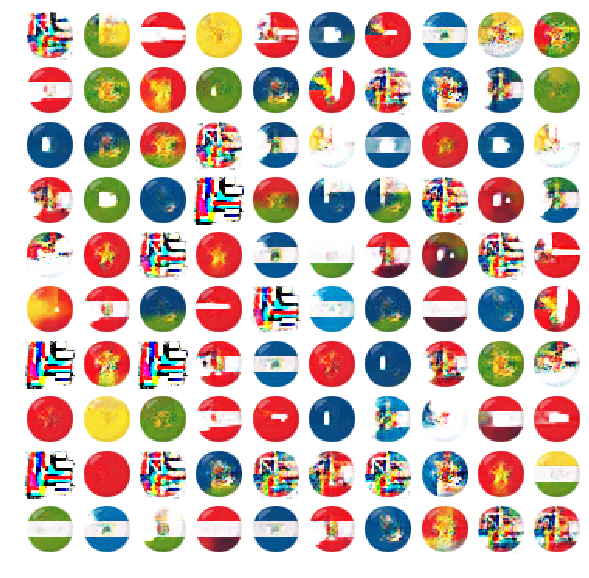

step: 8850, D_loss: 0.020425, D_accuracy: 100.00%, G_loss: 5.846903
step: 8900, D_loss: 0.030471, D_accuracy: 99.22%, G_loss: 7.046628
step: 8950, D_loss: 0.024545, D_accuracy: 100.00%, G_loss: 5.827716
step: 9000, D_loss: 0.341575, D_accuracy: 88.28%, G_loss: 7.437292


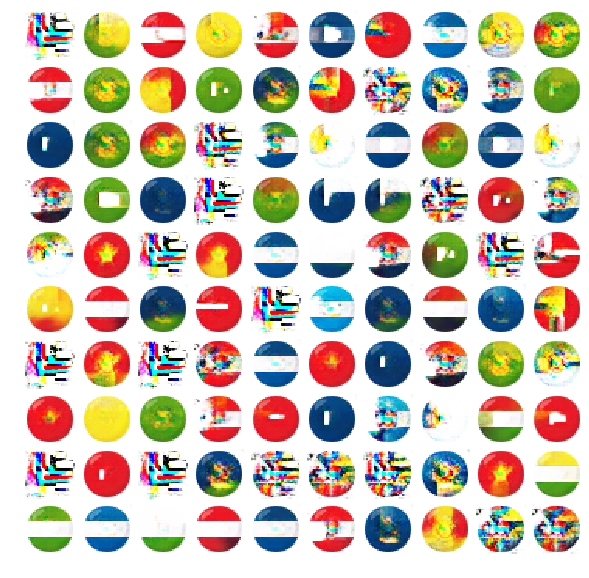

step: 9050, D_loss: 0.049332, D_accuracy: 99.22%, G_loss: 6.899179
step: 9100, D_loss: 0.066186, D_accuracy: 98.44%, G_loss: 6.339644
step: 9150, D_loss: 0.018489, D_accuracy: 99.22%, G_loss: 6.924010
step: 9200, D_loss: 0.159243, D_accuracy: 92.19%, G_loss: 9.125055


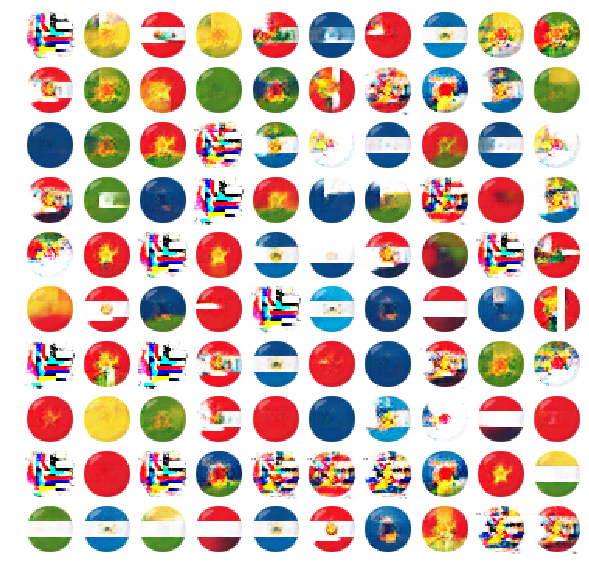

step: 9250, D_loss: 0.045021, D_accuracy: 99.22%, G_loss: 6.632737
step: 9300, D_loss: 0.034556, D_accuracy: 99.22%, G_loss: 5.997546
step: 9350, D_loss: 0.092735, D_accuracy: 96.09%, G_loss: 7.358140
step: 9400, D_loss: 0.262930, D_accuracy: 89.84%, G_loss: 10.899748


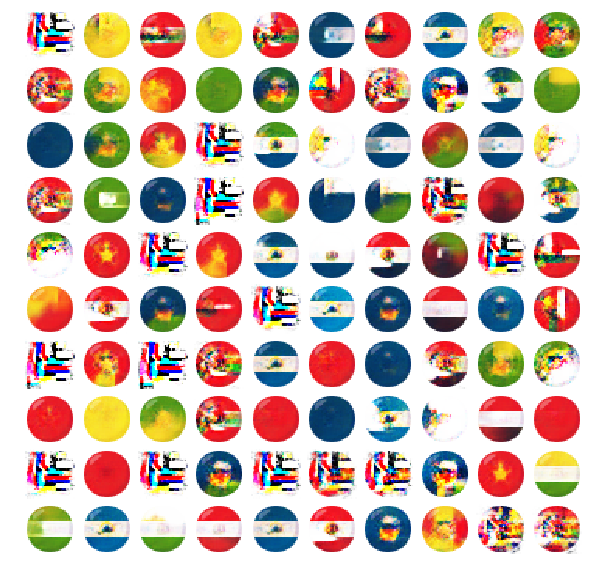

step: 9450, D_loss: 0.160490, D_accuracy: 91.41%, G_loss: 7.289077
step: 9500, D_loss: 0.036991, D_accuracy: 100.00%, G_loss: 5.935015
step: 9550, D_loss: 1.898139, D_accuracy: 73.44%, G_loss: 10.644459
step: 9600, D_loss: 0.030900, D_accuracy: 99.22%, G_loss: 6.123735


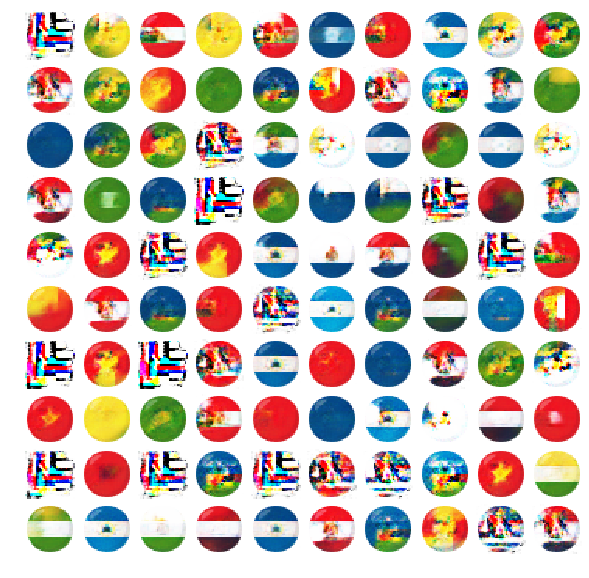

step: 9650, D_loss: 0.059509, D_accuracy: 97.66%, G_loss: 5.456430
step: 9700, D_loss: 0.582897, D_accuracy: 80.47%, G_loss: 9.352941
step: 9750, D_loss: 0.036554, D_accuracy: 99.22%, G_loss: 5.621929
step: 9800, D_loss: 0.252946, D_accuracy: 88.28%, G_loss: 9.044046


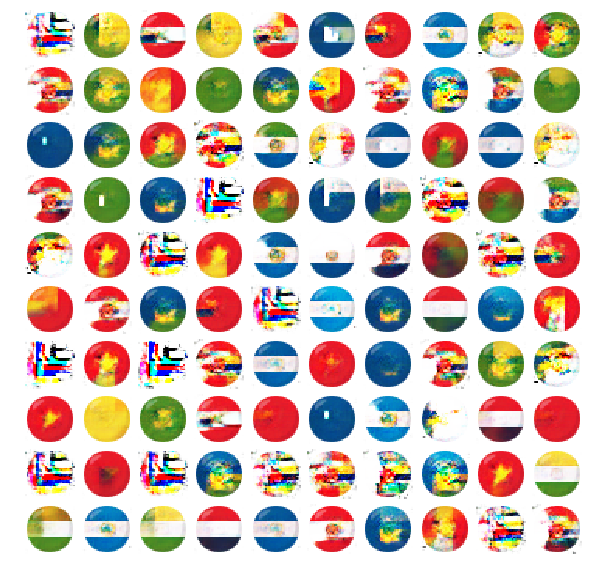

step: 9850, D_loss: 0.013419, D_accuracy: 100.00%, G_loss: 6.442399
step: 9900, D_loss: 0.022598, D_accuracy: 100.00%, G_loss: 5.709813
step: 9950, D_loss: 0.063374, D_accuracy: 99.22%, G_loss: 5.790776
step: 10000, D_loss: 0.025792, D_accuracy: 99.22%, G_loss: 5.979445


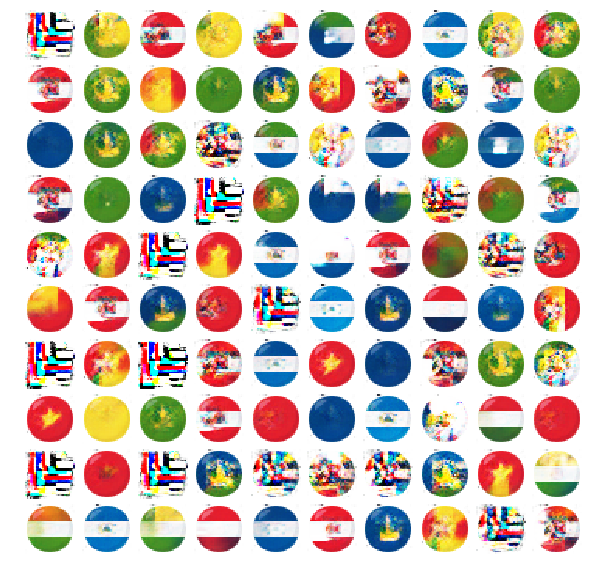

In [29]:
train(compiled_models, noise_size, img_shape, batch_size, steps)

## Plot resutls

In [0]:
%%capture
!pip install import_ipynb
%cd /content
%rm -r /content/0a16ae419d9eba160ddb4f48862fb9e2
!git clone https://gist.github.com/dkatsios/0a16ae419d9eba160ddb4f48862fb9e2.git
%cd /content/0a16ae419d9eba160ddb4f48862fb9e2
import import_ipynb
from IPython.display import HTML
from AnimationDisplay import plot_results
%cd /content

In [0]:
path = '/content/images/{}.png'
iterator = range(200, steps+1, 200)
HTML(plot_results(path, iterator).to_jshtml())

## Download images and generator

In [0]:
gen_path = '/content/gen.h5'
generator.save(gen_path)
from google.colab import files
files.download(gen_path)